In [5]:
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

pd.options.display.max_columns = 200

In [6]:
abnbdata = pd.read_csv("unq_listings_loc_rev.csv")
print(len(abnbdata.index))
abnbdata.head()

51692


,Unnamed: 0,amenities_count,availability_30,availability_365,availability_60,availability_90,bathrooms,bed_type,bedrooms,beds,borough,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,cancellation_policy,cleaning_fee,guests_included,has_availability,host_exp,host_id,host_identity_verified,host_is_superhost,host_response_rate,host_response_time,host_total_listings_count,is_aircon,is_business_travel_ready,is_heating,is_instant_bookable,is_kitchen,is_smoke_detector,is_wifi,listing_id,maximum_nights,minimum_nights,mode_price,neighbourhood,number_of_reviews,number_of_reviews_ltm,price_01-2019,price_02-2019,price_03-2019,price_04-2019,price_05-2019,price_06-2019,price_07-2019,price_for_extra_people,property_type,require_guest_phone_verification,require_guest_profile_picture,review_scores_accuracy,review_scores_checkin,review_scores_cleanliness,review_scores_communication,review_scores_location,review_scores_rating,review_scores_value,reviews_per_month,room_type,security_deposit,price_01-2020,price_02-2020,price_08-2019,price_12-2019,price_09-2019,price_10-2019,price_11-2019,latitude,longitude,count_reviews
0,0,44.0,30.0,365.0,60.0,90.0,1.0,Real Bed,1.0,1.0,Brooklyn,6.0,0.0,5.0,1.0,moderate,25.0,1.0,1.0,3957.0,2787.0,1.0,0.0,100.0,within an hour,6.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,2539.0,730.0,1.0,149.0,Kensington,9.0,2.0,149.0,149.0,149.0,129.0,129.0,149.0,149.0,35.0,Apartment,0.0,0.0,10.0,10.0,10.0,10.0,10.0,98.0,10.0,0.22,Private room,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.647486,-73.972370,63
1,1,44.0,30.0,365.0,60.0,90.0,1.0,Real Bed,1.0,1.0,Brooklyn,6.0,0.0,5.0,1.0,moderate,25.0,1.0,1.0,3957.0,2787.0,1.0,0.0,100.0,within an hour,6.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,2539.0,730.0,1.0,149.0,Kensington,9.0,2.0,149.0,149.0,149.0,129.0,129.0,149.0,149.0,35.0,Apartment,0.0,0.0,10.0,10.0,10.0,10.0,10.0,98.0,10.0,0.22,Private room,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.647490,-73.972370,63
2,2,40.0,30.0,365.0,60.0,90.0,1.0,Real Bed,0.0,1.0,Manhattan,2.0,1.0,0.0,1.0,strict_14_with_grace_period,100.0,2.0,1.0,4173.0,2845.0,1.0,0.0,60.0,within a day,5.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,2595.0,1125.0,1.0,225.0,Midtown,43.0,14.0,225.0,225.0,225.0,225.0,225.0,225.0,225.0,0.0,Apartment,1.0,1.0,9.0,10.0,9.0,10.0,10.0,95.0,9.0,0.39,Entire home/apt,350.0,225.0,225.0,225.0,225.0,NaN,NaN,NaN,40.753621,-73.983774,494
3,3,40.0,30.0,365.0,60.0,90.0,1.0,Real Bed,0.0,1.0,Manhattan,2.0,1.0,0.0,1.0,strict_14_with_grace_period,100.0,2.0,1.0,4173.0,2845.0,1.0,0.0,60.0,within a day,5.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,2595.0,1125.0,1.0,225.0,Midtown,43.0,14.0,225.0,225.0,225.0,225.0,225.0,225.0,225.0,0.0,Apartment,1.0,1.0,9.0,10.0,9.0,10.0,10.0,95.0,9.0,0.39,Entire home/apt,350.0,225.0,225.0,225.0,225.0,NaN,NaN,NaN,40.753620,-73.983770,494
4,4,25.0,1.0,217.0,7.0,40.0,1.0,Real Bed,1.0,1.0,Brooklyn,3.0,0.0,3.0,0.0,strict_14_with_grace_period,125.0,2.0,1.0,3797.0,4177.0,1.0,0.0,100.0,within a few hours,4.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,3330.0,730.0,5.0,70.0,Williamsburg,39.0,12.0,70.0,NaN,70.0,70.0,NaN,NaN,NaN,50.0,Apartment,0.0,0.0,10.0,10.0,10.0,10.0,10.0,97.0,10.0,0.35,Private room,150.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.708558,-73.942362,156


# Data Preparation

### Convert boolean values into 0/1

In [7]:
# def get_binary(x):
#     if x is True:
#         return 1
#     else: 
#         return 0

# abnbdata['has_availability'] = abnbdata['has_availability'].apply(lambda x: get_binary(x))
# abnbdata['is_instant_bookable'] = abnbdata['is_instant_bookable'].apply(lambda x: get_binary(x))
# abnbdata['is_business_travel_ready'] = abnbdata['is_business_travel_ready'].apply(lambda x: get_binary(x))
# abnbdata['is_wifi'] = abnbdata['is_wifi'].apply(lambda x: get_binary(x))
# abnbdata['is_heating'] = abnbdata['is_heating'].apply(lambda x: get_binary(x))
# abnbdata['is_smoke_detector'] = abnbdata['is_smoke_detector'].apply(lambda x: get_binary(x))
# abnbdata['is_aircon'] = abnbdata['is_aircon'].apply(lambda x: get_binary(x))
# abnbdata['host_is_superhost'] = abnbdata['host_is_superhost'].apply(lambda x: get_binary(x))

### converting neighborhood and borough into values

In [8]:
# # print(airbnb_raw['neighbourhood'].unique())
# # print(airbnb_raw['borough'].unique())
# abnbdata['cat_neighbourhood'] = abnbdata['neighbourhood'].astype('category').cat.codes
# abnbdata['cat_borough'] = abnbdata['borough'].astype('category').cat.codes
# abnbdata['cat_cancellation_policy'] = abnbdata['cancellation_policy'].astype('category').cat.codes
# abnbdata['cat_host_response_time'] = abnbdata['host_response_time'].astype('category').cat.codes
# abnbdata['cat_property_type'] = abnbdata['property_type'].astype('category').cat.codes
# abnbdata['cat_room_type'] = abnbdata['room_type'].astype('category').cat.codes

In [20]:
del abnbdata['Unnamed: 0']
price_cols = ['price_01-2020', 'price_02-2020', 'price_01-2019', 'price_02-2019', 'price_03-2019', 'price_04-2019', 'price_05-2019', \
              'price_06-2019', 'price_07-2019', 'price_08-2019', 'price_09-2019', 'price_10-2019', 'price_11-2019', 'price_12-2019']
non_imp_cols = ["latitude", "longitude"]
get_dummy = ["room_type", "property_type", "neighbourhood", "host_response_time", "cancellation_policy", "borough", "bed_type"]
imp_cols = "cat_host_response_time,host_response_rate,host_is_superhost,host_total_listings_count,cat_neighbourhood,cat_borough,cat_property_type, \
cat_room_type,bathrooms,bedrooms,beds, amenities_count, is_wifi, is_kitchen, is_heating, is_smoke_detector, is_aircon, security_deposit, \
cleaning_fee, price_for_extra_people, guests_included, minimum_nights, maximum_nights, has_availability,  is_instant_bookable, \
is_business_travel_ready, cat_cancellation_policy,number_of_reviews_ltm, review_scores_rating, review_scores_accuracy, review_scores_cleanliness, \
review_scores_checkin, review_scores_communication, review_scores_location, review_scores_value, count_reviews"

### Dummy variables

In [10]:
abnbdata = pd.get_dummies(abnbdata, prefix=get_dummy)
abnbdata.head()

,amenities_count,availability_30,availability_365,availability_60,availability_90,bathrooms,bedrooms,beds,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,cleaning_fee,guests_included,has_availability,host_exp,host_id,host_identity_verified,host_is_superhost,host_response_rate,host_total_listings_count,is_aircon,is_business_travel_ready,is_heating,is_instant_bookable,is_kitchen,is_smoke_detector,is_wifi,listing_id,maximum_nights,minimum_nights,mode_price,number_of_reviews,number_of_reviews_ltm,price_01-2019,price_02-2019,price_03-2019,price_04-2019,price_05-2019,price_06-2019,price_07-2019,price_for_extra_people,require_guest_phone_verification,require_guest_profile_picture,review_scores_accuracy,review_scores_checkin,review_scores_cleanliness,review_scores_communication,review_scores_location,review_scores_rating,review_scores_value,reviews_per_month,security_deposit,price_01-2020,price_02-2020,price_08-2019,price_12-2019,price_09-2019,price_10-2019,price_11-2019,latitude,longitude,count_reviews,room_type_Airbed,room_type_Couch,room_type_Futon,room_type_Pull-out Sofa,room_type_Real Bed,property_type_Bronx,property_type_Brooklyn,property_type_Manhattan,property_type_Queens,property_type_Staten Island,neighbourhood_flexible,neighbourhood_moderate,neighbourhood_strict,neighbourhood_strict_14_with_grace_period,neighbourhood_super_strict_30,neighbourhood_super_strict_60,host_response_time_a few days or more,host_response_time_within a day,host_response_time_within a few hours,host_response_time_within an hour,cancellation_policy_Allerton,cancellation_policy_Arden Heights,cancellation_policy_Arrochar,cancellation_policy_Arverne,cancellation_policy_Astoria,cancellation_policy_Bath Beach,cancellation_policy_Battery Park City,cancellation_policy_Bay Ridge,cancellation_policy_Bay Terrace,"cancellation_policy_Bay Terrace, Staten Island",cancellation_policy_Baychester,cancellation_policy_Bayside,cancellation_policy_Bayswater,cancellation_policy_Bedford-Stuyvesant,cancellation_policy_Belle Harbor,cancellation_policy_Bellerose,cancellation_policy_Belmont,...,cancellation_policy_Pelham Gardens,cancellation_policy_Port Morris,cancellation_policy_Port Richmond,cancellation_policy_Prince's Bay,cancellation_policy_Prospect Heights,cancellation_policy_Prospect-Lefferts Gardens,cancellation_policy_Queens Village,cancellation_policy_Randall Manor,cancellation_policy_Red Hook,cancellation_policy_Rego Park,cancellation_policy_Richmond Hill,cancellation_policy_Ridgewood,cancellation_policy_Riverdale,cancellation_policy_Rockaway Beach,cancellation_policy_Roosevelt Island,cancellation_policy_Rosebank,cancellation_policy_Rosedale,cancellation_policy_Schuylerville,cancellation_policy_Sea Gate,cancellation_policy_Sheepshead Bay,cancellation_policy_Shore Acres,cancellation_policy_Silver Lake,cancellation_policy_SoHo,cancellation_policy_Soundview,cancellation_policy_South Beach,cancellation_policy_South Ozone Park,cancellation_policy_South Slope,cancellation_policy_Springfield Gardens,cancellation_policy_Spuyten Duyvil,cancellation_policy_St. Albans,cancellation_policy_St. George,cancellation_policy_Stapleton,cancellation_policy_Stuyvesant Town,cancellation_policy_Sunnyside,cancellation_policy_Sunset Park,cancellation_policy_Theater District,cancellation_policy_Throgs Neck,cancellation_policy_Todt Hill,cancellation_policy_Tompkinsville,cancellation_policy_Tottenville,cancellation_policy_Tremont,cancellation_policy_Tribeca,cancellation_policy_Two Bridges,cancellation_policy_Unionport,cancellation_policy_University Heights,cancellation_policy_Upper East Side,cancellation_policy_Upper West Side,cancellation_policy_Van Nest,cancellation_policy_Vinegar Hill,cancellation_policy_Wakefield,cancellation_policy_Washington Heights,cancellation_policy_West Brighton,cancellation_policy_West Farms,cancellation_policy_West Village,cancellation_policy_Westches

In [12]:
abnbdata = abnbdata.drop(columns=non_imp_cols)

### Correlation Matrix

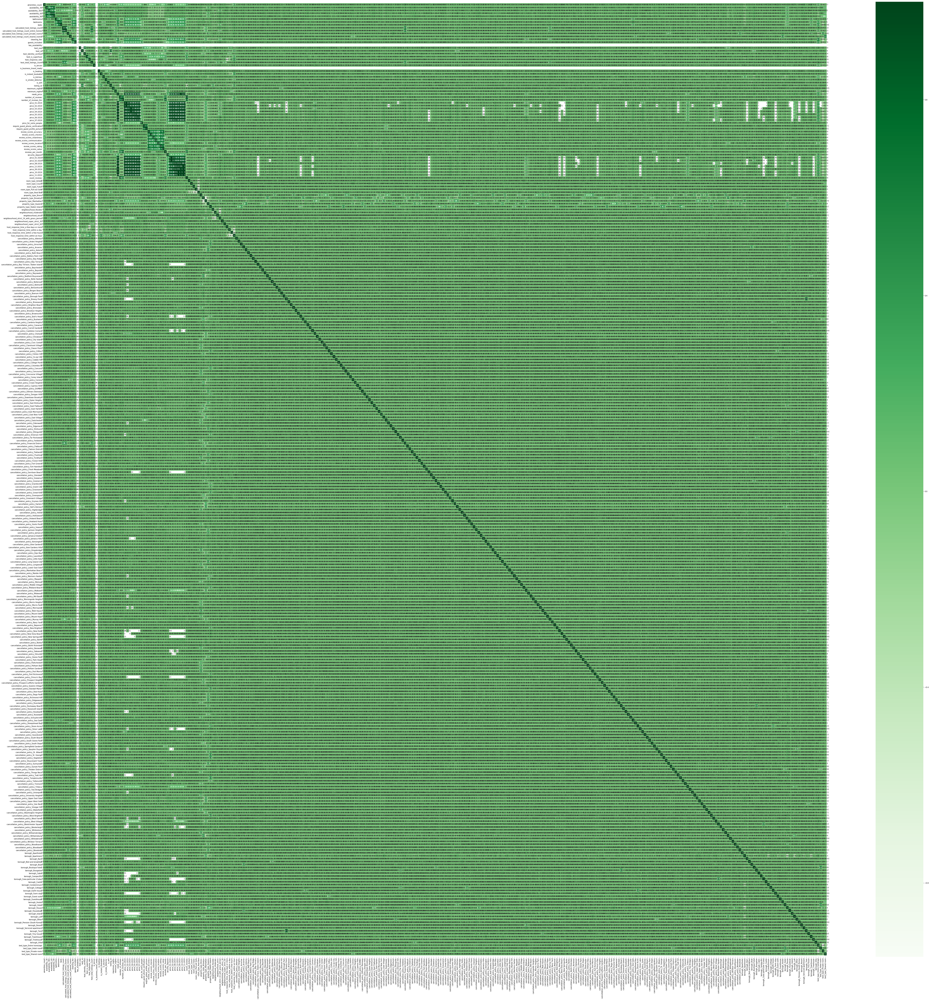

In [13]:
corrmat = abnbdata.corr()
f, ax = plt.subplots(figsize=(100,100))
sns.heatmap(corrmat, annot=True, cmap = 'Greens')

# Fix box height
b, t = plt.ylim()
b += 0.5 # Add 0.5 to the bottom
t -= 0.5 # Subtract 0.5 from the top
plt.ylim(b, t) 
plt.savefig('Correlation_matrix_listings.png', dpi=300)
plt.show()

# Exploring Price

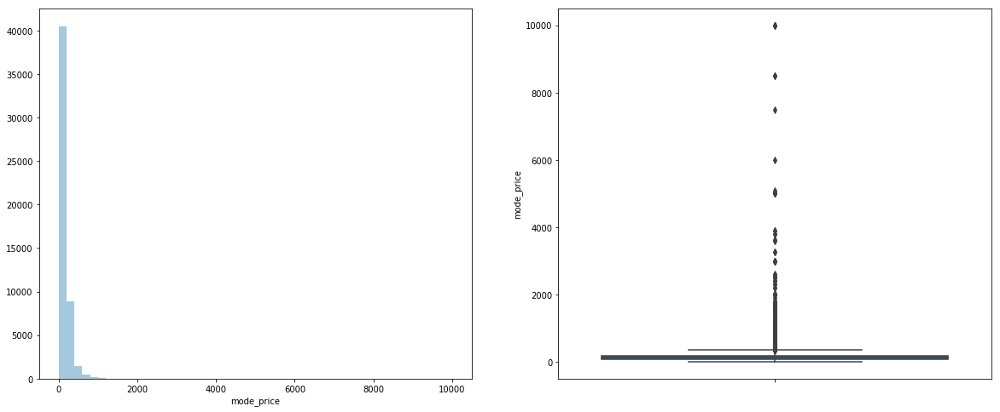

In [14]:
#Price has extreme outliers, and is very skewed
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,8))
sns.distplot(abnbdata['mode_price'], kde=False, ax=axes[0])
sns.boxplot(x='mode_price', data=abnbdata, orient="v",ax=axes[1])
plt.show()

115.0
Number of outliers: 3318
Old mean: 154.85
New mean: 125.37


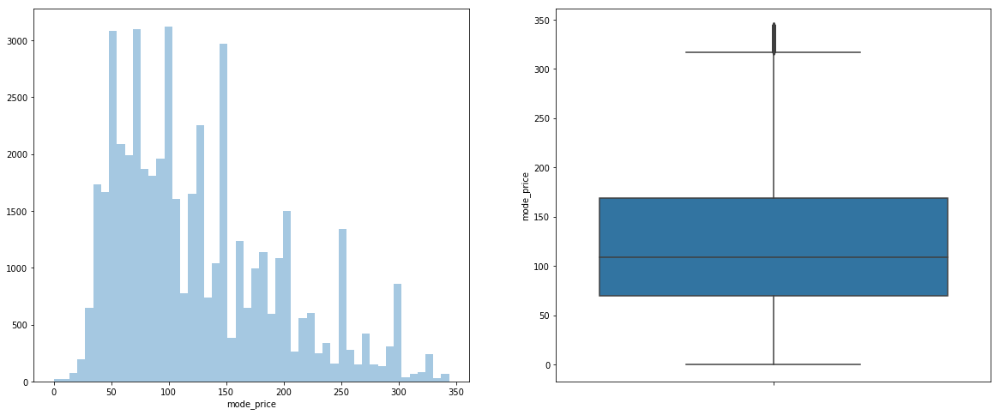

In [15]:
q1_price = np.percentile(abnbdata['mode_price'], 25, interpolation='midpoint')
q3_price = np.percentile(abnbdata['mode_price'], 75, interpolation='midpoint')
iqr = q3_price - q1_price
print(iqr)
print("Number of outliers:", abnbdata[abnbdata['mode_price']>(3*iqr)]['mode_price'].count())
print("Old mean:", round(abnbdata['mode_price'].mean(),2))
print("New mean:", round(abnbdata[abnbdata['mode_price']<(3*iqr)]['mode_price'].mean(),2))

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,8))
sns.distplot(abnbdata[abnbdata['mode_price']<(3*iqr)]['mode_price'], kde=False, ax=axes[0])
sns.boxplot(x='mode_price', data=abnbdata[abnbdata['mode_price']<(3*iqr)], orient="v",ax=axes[1])
plt.show()

## Evaluation metrics

In [16]:
# Reference: https://scikit-learn.org/stable/modules/model_evaluation.html#the-scoring-parameter-defining-model-evaluation-rules
from sklearn import metrics
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import math
from statistics import mean

def evaluate(y_true, y_pred):
    y_true = y_true['mode_price'].tolist()
    print("MSE: ", round(mean_squared_error(y_true, y_pred), 4))
    print("RMSE: ",round(math.sqrt(mean_squared_error(y_true, y_pred)), 4))
    
    nr = (mean_squared_error(y_true, y_pred)) * len(y_true)
    mean_y_true = mean(y_true)
    dr = sum([(mean_y_true - float(x))**2 for x in y_true])
    rrmse = 100 * math.sqrt(nr/dr)
    print("RRMSE: ",round(rrmse, 4))
    
    print("MAE: ", round(mean_absolute_error(y_true, y_pred), 4))
    print("R2: ", round(r2_score(y_true, y_pred), 4))

## Train-test data split

In [25]:
from sklearn.model_selection import train_test_split

## removing the price columns
abnbdata = abnbdata.drop(columns=price_cols)

abnbdata['log_price'] = np.log(abnbdata['mode_price'])
predicting = ['mode_price']
predicting_log = ['log_price']

train, test = train_test_split(abnbdata, train_size=0.7, shuffle=True)
X_train, y_train, y_train_log = train[[col for col in train.columns if (col != 'mode_price' and col != 'log_price')]], train[predicting], train[predicting_log]
X_test, y_test = test[[col for col in train.columns if (col != 'mode_price' and col != 'log_price')]], test[predicting]

/home/toshal/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log
  
/home/toshal/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_split.py:2179: FutureWarning: From version 0.21, test_size will always complement train_size unless both are specified.
  FutureWarning)


# Models

## XGBOOST

- Train set results:
MSE:  2927.0406
RMSE:  54.1021
RRMSE:  28.1614
MAE:  25.1975
R2:  0.9207


- Test set results:
MSE:  12301.5846
RMSE:  110.9125
RRMSE:  61.7583
MAE:  34.9882
R2:  0.6186


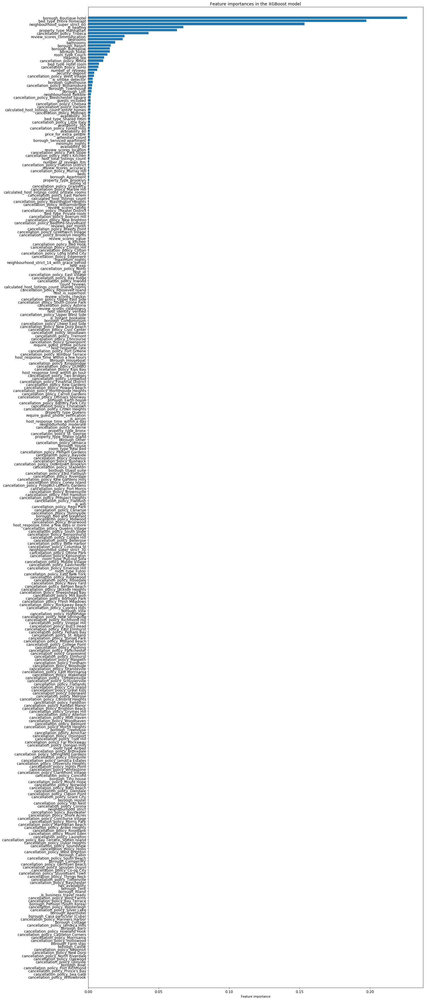

In [44]:
import xgboost as xgb

# Fitting the model
# xgb_reg = xgb.XGBRegressor()
# xgb_reg.fit(X_train, y_train)
# training_preds_xgb_reg = xgb_reg.predict(X_train)
# val_preds_xgb_reg = xgb_reg.predict(X_test)

xg_reg = xgb.XGBRegressor(learning_rate = 0.01,n_estimators= 200, min_samples_leaf= 20, max_features = 62, max_depth= 32)
xg_reg.fit(X_train,y_train)
training_preds_xgb_reg = xg_reg.predict(X_train)
val_preds_xgb_reg = xg_reg.predict(X_test)

# Printing the results
#print(f"Time taken to run: {round((xgb_reg_end - xgb_reg_start)/60,1)} minutes")
print("- Train set results:")
evaluate(y_train, training_preds_xgb_reg)
print('\n')
print("- Test set results:")
evaluate(y_test, val_preds_xgb_reg)

# Producing a dataframe of feature importances
ft_weights_xgb_reg = pd.DataFrame(xg_reg.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg.sort_values('weight', inplace=True)

# Plotting feature importances
plt.figure(figsize=(20,60))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.title("Feature importances in the XGBoost model", fontsize=14)
plt.xlabel("Feature importance")
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.margins(y=0.01)
plt.show()

## Support Vector Regressor 

In [ ]:
import numpy as np
from sklearn.svm import SVR
import matplotlib.pyplot as plt

# Fit regression model
svr_rbf = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_lin = SVR(kernel='linear', C=100, gamma='auto')
svr_poly = SVR(kernel='poly', C=100, gamma='auto', degree=3, epsilon=.1,
               coef0=1)

# Look at the results
lw = 2

svrs = [svr_rbf, svr_lin, svr_poly]
kernel_label = ['RBF', 'Linear', 'Polynomial']
model_color = ['m', 'c', 'g']

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 10), sharey=True)
for ix, svr in enumerate(svrs):
    axes[ix].plot(X_train, svr.fit(X_train, y_train).predict(X_train), color=model_color[ix], lw=lw,
                  label='{} model'.format(kernel_label[ix]))
#     axes[ix].scatter(X_train[svr.support_], y_train[svr.support_], facecolor="none",
#                      edgecolor=model_color[ix], s=50,
#                      label='{} support vectors'.format(kernel_label[ix]))
#     axes[ix].scatter(X_train[np.setdiff1d(np.arange(len(X)), svr.support_)],
#                      y_train[np.setdiff1d(np.arange(len(X)), svr.support_)],
#                      facecolor="none", edgecolor="k", s=50,
#                      label='other training data')
    axes[ix].legend(loc='upper center', bbox_to_anchor=(0.5, 1.1),
                    ncol=1, fancybox=True, shadow=True)

fig.text(0.5, 0.04, 'data', ha='center', va='center')
fig.text(0.06, 0.5, 'target', ha='center', va='center', rotation='vertical')
fig.suptitle("Support Vector Regression", fontsize=14)
plt.show()

## Linear Regression

In [28]:
from sklearn.linear_model import LinearRegression

lr = LinearRegression()
lr.fit(X_train, y_train.values.ravel())

y_pred_train = lr.predict(X_train)
y_pred_test = lr.predict(X_test)

print("- Train set results:")
evaluate(y_train, y_pred_train)
print('\n')
print("- Test set results:")
evaluate(y_test, y_pred_test)

- Train set results:
MSE:  23396.1291
RMSE:  152.9579
RRMSE:  79.6181
MAE:  57.3417
R2:  0.3661


- Test set results:
MSE:  21351.8959
RMSE:  146.1229
RRMSE:  81.3642
MAE:  57.5491
R2:  0.338


## Neural Network: 4-layer feed forward network

In [29]:
from keras import models, layers, optimizers, regularizers
from keras.utils.vis_utils import model_to_dot
from IPython.display import SVG

# Building the model
nn2 = models.Sequential()
nn2.add(layers.Dense(512, input_shape=(X_train.shape[1],), activation='relu'))
nn2.add(layers.Dense(512, activation='relu'))
nn2.add(layers.Dense(256, activation='relu'))
nn2.add(layers.Dense(64, activation='relu'))
nn2.add(layers.Dense(16, activation='relu'))
nn2.add(layers.Dense(1, activation='relu'))

# Compiling the model
nn2.compile(loss='mean_squared_error',
            optimizer='adam',
            metrics=['mean_squared_error'])

# Printing the model summary
print(nn2.summary())

# Visualising the neural network
#SVG(model_to_dot(nn2, show_layer_names=False, show_shapes=True).create(prog='dot', format='svg'))

# Training the model
nn2_history = nn2.fit(X_train,
                  y_train,
                  epochs=1000,
                  batch_size=256,
                  validation_split = 0.1)


Using TensorFlow backend.


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 1000)              316000    
_________________________________________________________________
dense_2 (Dense)              (None, 512)               512512    
_________________________________________________________________
dense_3 (Dense)              (None, 256)               131328    
_________________________________________________________________
dense_4 (Dense)              (None, 64)                16448     
_________________________________________________________________
dense_5 (Dense)              (None, 16)                1040      
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 17        
Total params: 977,345
Trainable params: 977,345
Non-trainable params: 0
________________________________________________

- Train set results:
MSE:  60953.716
RMSE:  246.8881
RRMSE:  128.5109
MAE:  155.0669
R2:  -0.6515


- Test set results:
MSE:  56077.1796
RMSE:  236.8062
RRMSE:  131.8585
MAE:  154.3509
R2:  -0.7387


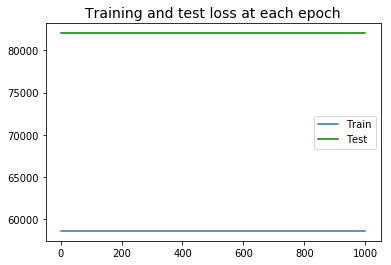

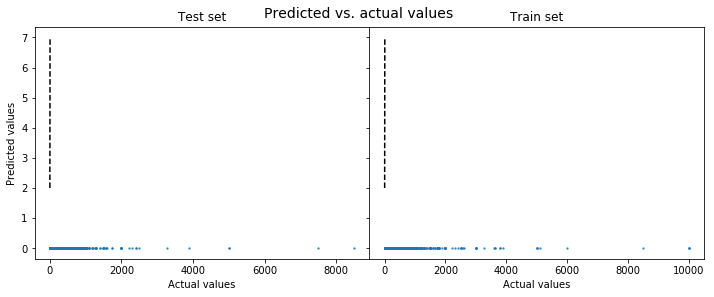

In [30]:
def nn_model_evaluation(model, skip_epochs=0, X_train=X_train, X_test=X_test, y_train=y_train, y_test=y_test):
    """
    For a given neural network model that has already been fit, prints for the train and tests sets the MSE and r squared
    values, a line graph of the loss in each epoch, and a scatterplot of predicted vs. actual values with a line
    representing where predicted = actual values. Optionally, a value for skip_epoch can be provided, which skips that
    number of epochs in the line graph of losses (useful in cases where the loss in the first epoch is orders of magnitude
    larger than subsequent epochs). Training and test sets can also optionally be specified.
    """

    # MSE and r squared values
    y_test_pred = model.predict(X_test)
    y_train_pred = model.predict(X_train)
    
    print("- Train set results:")
    evaluate(y_train, y_train_pred)
    print('\n')
    print("- Test set results:")
    evaluate(y_test, y_test_pred)
    
    # Line graph of losses
    model_results = model.history.history
    plt.plot(list(range((skip_epochs+1),len(model_results['loss'])+1)), model_results['loss'][skip_epochs:], label='Train')
    plt.plot(list(range((skip_epochs+1),len(model_results['val_loss'])+1)), model_results['val_loss'][skip_epochs:], label='Test', color='green')
    plt.legend()
    plt.title('Training and test loss at each epoch', fontsize=14)
    plt.show()
    
    # Scatterplot of predicted vs. actual values
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
    plt.subplots_adjust(top=0.93, wspace=0)
    
    ax1.scatter(y_test, y_test_pred, s=2, alpha=0.7)
    ax1.plot(list(range(2,8)), list(range(2,8)), color='black', linestyle='--')
    ax1.set_title('Test set')
    ax1.set_xlabel('Actual values')
    ax1.set_ylabel('Predicted values')
    
    ax2.scatter(y_train, y_train_pred, s=2, alpha=0.7)
    ax2.plot(list(range(2,8)), list(range(2,8)), color='black', linestyle='--')
    ax2.set_title('Train set')
    ax2.set_xlabel('Actual values')
    ax2.set_ylabel('')
    ax2.set_yticklabels(labels='')
    
    plt.show()
    
nn_model_evaluation(nn2)

In [32]:
abnbdata['is_heating'].value_counts()

1.0    49921
0.0     1771
Name: is_heating, dtype: int64

In [33]:
abnbdata['review_scores_communication'].value_counts()

10.0    41891
9.0      7506
8.0      1514
6.0       278
7.0       243
2.0       144
4.0        74
5.0        33
3.0         9
Name: review_scores_communication, dtype: int64

In [34]:
abnbdata['review_scores_location'].value_counts()

10.0    33829
9.0     14877
8.0      2397
7.0       241
6.0       217
2.0        74
4.0        35
5.0        21
3.0         1
Name: review_scores_location, dtype: int64

In [35]:
len(abnbdata.columns)

317